# <b>Step 3-5. Model Selection through Hyper-parameter Tuning (Detectron2)
-----------------------------------------------------------------------------------------------------------------

## <b>1. Data Preparation

### 1) Set-up Basic Libraries

In [0]:
# Import some common libraries
import os
import cv2
import json
import random
import itertools
import numpy as np
from matplotlib import pyplot as plt

# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# Import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.config import get_cfg
from detectron2.structures import BoxMode
from detectron2.data import MetadataCatalog
from detectron2.utils.visualizer import Visualizer
from detectron2.data import DatasetCatalog, MetadataCatalog
from detectron2.data.datasets import register_coco_instances
from detectron2.engine import DefaultPredictor, DefaultTrainer

# from google.colab.patches import cv2_imshow # for google colab

In [2]:
# Current directory
print(f"Current directory: {os.getcwd()}")
ROOT_DIR = os.getcwd() + "/gdrive/My Drive/Car_Damage/"
print(f"Colab root directory: {ROOT_DIR}")

# Set values - choose a json file and image folder for train/validation
STR_dataset_name_val        = "dataset_val_aug_nonoise" # json file: val_base.json
STR_dataset_name_coco_val   = "dataset_val_base_coco"

STR_json_name_train         = "train_aug_nonoise.json" # modify here
STR_json_name_val           = "val_base.json"
STR_json_name_val_coco      = "val_base_coco.json"

STR_img_folder_train        = "train_aug_nonoise" 
STR_img_folder_val          = "val_base"

STR_anno_path               = "dataset/annotations"
STR_json_path               = ROOT_DIR + STR_anno_path + "/"

Current directory: /content
Colab root directory: /content/gdrive/My Drive/Car_Damage/


### 2) Create and Register Dataset

In [0]:
# Define training dataset dicts
def car_damage_dicts(img_dir):    
    if "train" in img_dir:
        json_file_name = STR_json_name_train
    else:
        json_file_name = STR_json_name_val
        
    json_file_dir = os.path.join(ROOT_DIR + STR_anno_path, json_file_name)

    with open(json_file_dir) as f:
        imgs_anns = json.load(f)

    dataset_dicts = []
    for _, v in imgs_anns.items():
        record = {}
        
        filename = os.path.join(img_dir, v["filename"])
        height, width = cv2.imread(filename).shape[:2]
        
        record["file_name"] = filename
        record["height"] = height
        record["width"] = width
      
        annos = v["regions"]
        objs = []
        
        # Added codes here to extract the class of damage
        classes = ["scratch", "dent"]
               
        for anno in annos:
            category_id = classes.index(dict(anno["region_attributes"])["damage"])  
            anno = anno["shape_attributes"]
            px = anno["all_points_x"]
            py = anno["all_points_y"]
            poly = [(x + 0.5, y + 0.5) for x, y in zip(px, py)]
            poly = list(itertools.chain.from_iterable(poly))

            obj = {
                "bbox": [np.min(px), np.min(py), np.max(px), np.max(py)],
                "bbox_mode": BoxMode.XYXY_ABS,
                "segmentation": [poly],
                # Replace integer zero to variable for two classes
                "category_id": category_id, # class: 0 - scratch, 1 - dent
                "iscrowd": 0
            }
            objs.append(obj)

        record["annotations"] = objs
        dataset_dicts.append(record)
    return dataset_dicts

# Register training dataset that is not in COCO format
for d in [STR_img_folder_train, STR_img_folder_val ]:
    DatasetCatalog.register("dataset_" + d, lambda d = d: car_damage_dicts(ROOT_DIR + "dataset/" + d)) # registered dataset name, image folder path
    MetadataCatalog.get("dataset_" + d).set(thing_classes=["scratch", "dent"])
damage_metadata = MetadataCatalog.get("dataset_" + STR_img_folder_train)

# Register validation dataset that is in COCO format
# If not, the evaluation function will raise errors.
# register_coco_instances(name, metadata, json_file, image_root)
register_coco_instances(STR_dataset_name_coco_val, {}, STR_json_path + STR_json_name_val_coco, ROOT_DIR + "dataset/" + STR_img_folder_val)

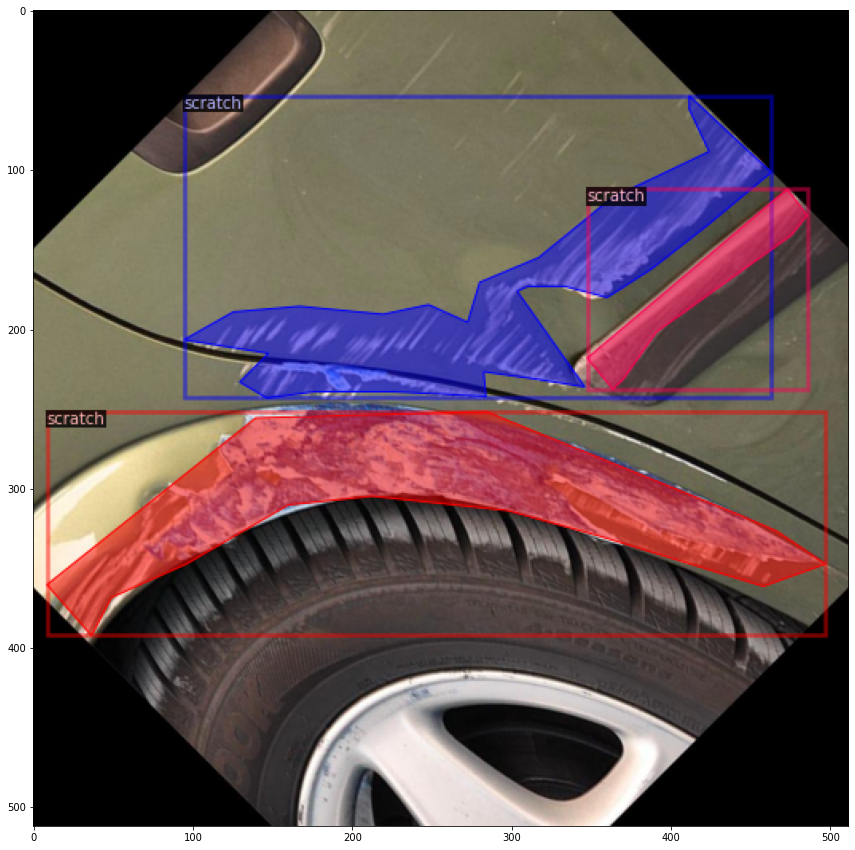

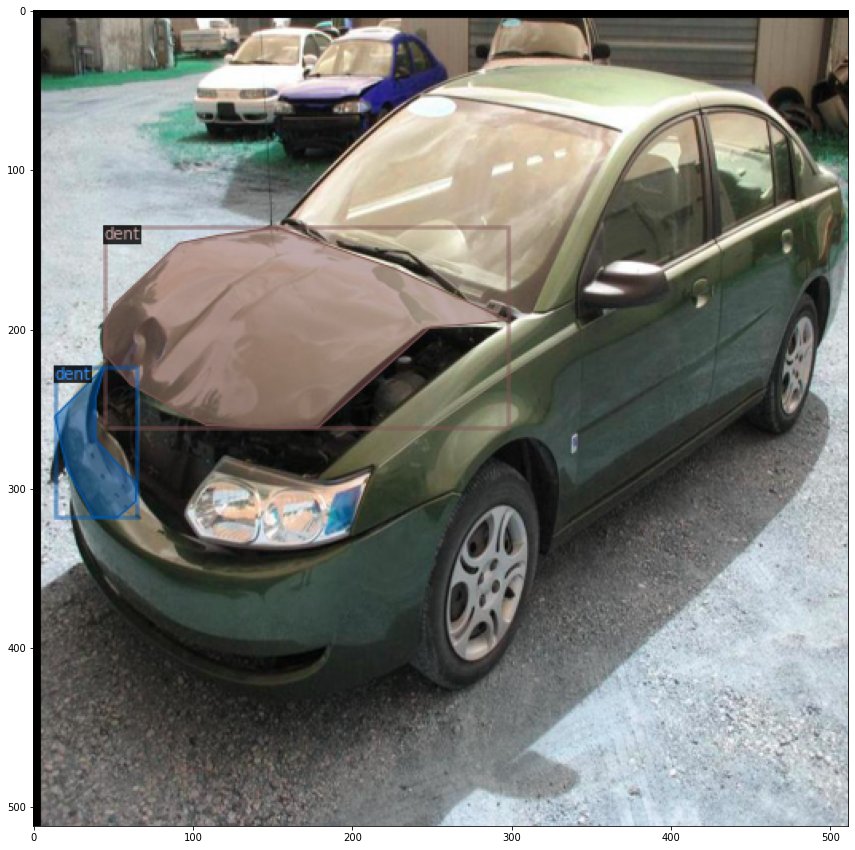

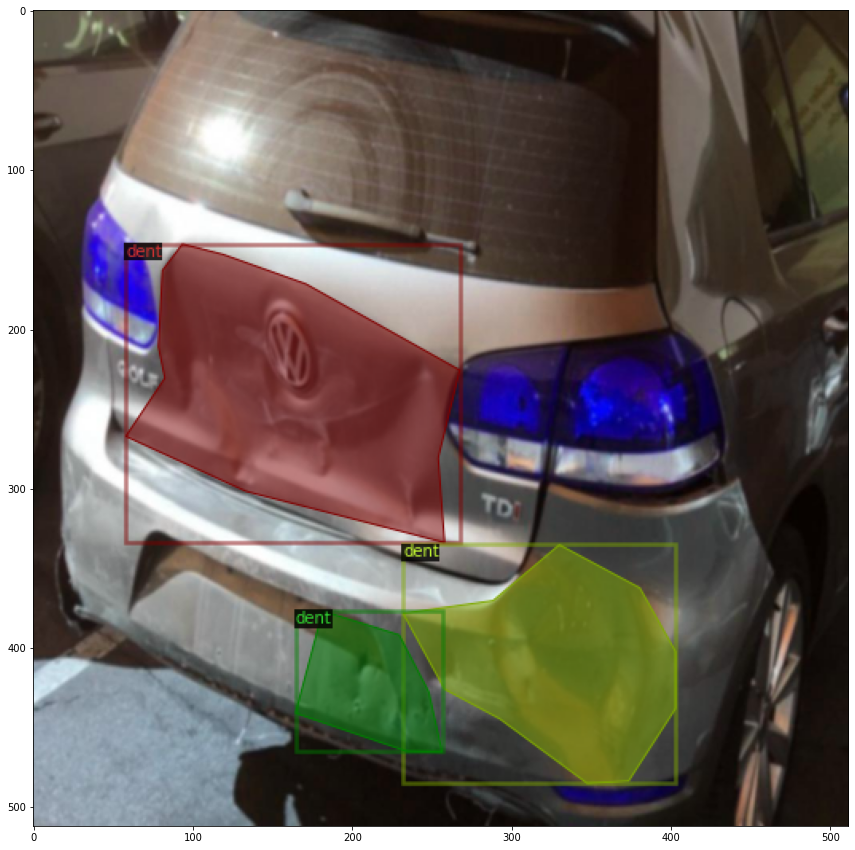

In [4]:
# Verify the data loading is correct and visualise the annotations of images
dataset_dicts = car_damage_dicts(ROOT_DIR + "dataset/" + STR_img_folder_train) # training dataset

for d in random.sample(dataset_dicts, 3): # select randomly samples in a training set
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata = damage_metadata, scale=0.5)
    vis = visualizer.draw_dataset_dict(d)
    plt.figure(figsize = (15,15))
    plt.imshow(vis.get_image()[:, :, ::-1])
    plt.show()

## <br><b> 2. Fine-tune Pretrained Mask R-CNN Models

In [0]:
# ---------------------------------------------------
# Set alternative values for conducting an experiment
# ---------------------------------------------------
# Best Parameters
# PARAM_lr = 25e-5
# PARAM_iter = 5000
# PARAM_batch_size = 512
# PARAM_workers = 2
# PARAM_per_batch = 2
# PARAM_classes = 2

# COCO models: 'Augmentation only' , LVIS model: 'Aug + TTA'
# The above models generated best performance under the conditions.

# # Moreover, we will not use the below parameters
# # added for test of hyper-parameter tuning
# cfg.SOLVER.STEPS = (1000, 1500)
# cfg.SOLVER.GAMMA = 0.05
# cfg.SOLVER.WARMUP_ITERS = 1000

# Baseline Parameters
PARAM_lr = 5e-5
PARAM_iter = 3000
PARAM_batch_size = 512
PARAM_workers = 2
PARAM_per_batch = 2
PARAM_classes = 2

#### <b>[Improvement]</b> Image Augmentation during Training Time

In [0]:
# ----------------------------------------------------------------------------------------
# Write a Custom Dataloader for Image Augmentation during Training Time
# Using a different "mapper" with build_detection_{train,test}_loader(mapper=) works 
# for most use cases of custom data loading
# ----------------------------------------------------------------------------------------
from detectron2.data import build_detection_train_loader
from detectron2.data import transforms as T
from detectron2.data import detection_utils as utils
import torch
import copy

def custom_mapper(input_dict):
    dataset_dict = copy.deepcopy(input_dict)  # it will be modified by code below
    image = utils.read_image(dataset_dict["file_name"], format="BGR")
    transform_list = [T.RandomFlip(prob=0.5, horizontal=True, vertical=False), # Random horizontal flip
                      T.RandomFlip(prob=0.5, horizontal=False, vertical=True), # Random vertical flip
                      ]
    image, transforms = T.apply_transform_gens(transform_list, image)
    dataset_dict["image"] = torch.as_tensor(image.transpose(2, 0, 1).astype("float32"))
    annos = [
        utils.transform_instance_annotations(obj, transforms, image.shape[:2])
        for obj in dataset_dict.pop("annotations")
    ]
    instances = utils.annotations_to_instances(annos, image.shape[:2])
    dataset_dict["instances"] = utils.filter_empty_instances(instances)
    # print("Data Augmentation...")
    return dataset_dict

# Use a Custom Dataloader
# In order to adopt DefaultTrainer, overwrite its build_{train,test}_loader method to use your own dataloader
# Rather than "trainer = DefaultTrainer(cfg)", use "trainer =  Trainer(cfg)"

class Trainer(DefaultTrainer):
    @classmethod
    def build_train_loader(cls, cfg):
      # Use custom_mapper, not the Default_mapper of 'DatasetMapper'
      return build_detection_train_loader(cfg, mapper = custom_mapper) 

### 1) COCO Mask R-CNN <b>ResNet-50 FPN 1x</b> Backbone

#### <b>[Step1]</b> Train, Fine-tune a coco-pretrained Mask R-CNN model on the 'car damage' dataset

In [7]:
# Train the model
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_1x.yaml"))
cfg.DATASETS.TRAIN = ("dataset_" + STR_img_folder_train,) # "dataset_" + image folder name
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = PARAM_workers # On Windows: 0 (zero)
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_1x.yaml")
cfg.SOLVER.IMS_PER_BATCH = PARAM_per_batch
cfg.SOLVER.BASE_LR = PARAM_lr
cfg.SOLVER.MAX_ITER = PARAM_iter    # 300 iterations
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = PARAM_batch_size   # default: 512
cfg.MODEL.ROI_HEADS.NUM_CLASSES = PARAM_classes  # two classes: class 0 - scratch, 1 - dent

# added for test of hyper-parameter tuning
cfg.SOLVER.STEPS = (1000, 1500)
cfg.SOLVER.GAMMA = 0.05
cfg.SOLVER.WARMUP_ITERS = 1000

os.makedirs(cfg.OUTPUT_DIR, exist_ok = True)
# trainer =  Trainer(cfg)
trainer = DefaultTrainer(cfg) # do not use TTA
trainer.resume_or_load(resume = False)
trainer.train()

[05/05 16:15:21 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

'roi_heads.box_predictor.cls_score.weight' has shape (81, 1024) in the checkpoint but (3, 1024) in the model! Skipped.
'roi_heads.box_predictor.cls_score.bias' has shape (81,) in the checkpoint but (3,) in the model! Skipped.
'roi_heads.box_predictor.bbox_pred.weight' has shape (320, 1024) in the checkpoint but (8, 1024) in the model! Skipped.
'roi_heads.box_predictor.bbox_pred.bias' has shape (320,) in the checkpoint but (8,) in the model! Skipped.
'roi_heads.mask_head.predictor.weight' has shape (80, 256, 1, 1) in the checkpoint but (2, 256, 1, 1) in the model! Skipped.
'roi_heads.mask_head.predictor.bias' has shape (80,) in the checkpoint but (2,) in the model! Skipped.


[05/05 16:15:31 d2.engine.train_loop]: Starting training from iteration 0
[05/05 16:15:37 d2.utils.events]:  eta: 0:12:55  iter: 19  total_loss: 1.998  loss_cls: 1.048  loss_box_reg: 0.135  loss_mask: 0.695  loss_rpn_cls: 0.086  loss_rpn_loc: 0.020  time: 0.2601  data_time: 0.0188  lr: 0.000001  max_mem: 1858M
[05/05 16:15:42 d2.utils.events]:  eta: 0:12:56  iter: 39  total_loss: 1.950  loss_cls: 1.025  loss_box_reg: 0.124  loss_mask: 0.696  loss_rpn_cls: 0.097  loss_rpn_loc: 0.017  time: 0.2604  data_time: 0.0058  lr: 0.000002  max_mem: 1859M
[05/05 16:15:47 d2.utils.events]:  eta: 0:12:46  iter: 59  total_loss: 1.871  loss_cls: 0.984  loss_box_reg: 0.101  loss_mask: 0.694  loss_rpn_cls: 0.036  loss_rpn_loc: 0.016  time: 0.2593  data_time: 0.0054  lr: 0.000003  max_mem: 1859M
[05/05 16:15:52 d2.utils.events]:  eta: 0:12:33  iter: 79  total_loss: 1.815  loss_cls: 0.926  loss_box_reg: 0.095  loss_mask: 0.694  loss_rpn_cls: 0.068  loss_rpn_loc: 0.021  time: 0.2578  data_time: 0.0049  lr:

In [8]:
# Check training curves in tensorboard
# Before run this script, execute "cd Car_Damage", "tensorboard --logdir output" in anaconda prompt command lines
%load_ext tensorboard
%tensorboard --logdir output

Reusing TensorBoard on port 6006 (pid 1059), started 3:16:48 ago. (Use '!kill 1059' to kill it.)

<IPython.core.display.Javascript object>

#### <b>[Step2]</b> Evaluation with the Trained Model

In [9]:
# Evaluate its performance using AP metric implemented in COCO API (ex. AP of ~70%)
# Use a COCO format json file
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader

evaluator = COCOEvaluator(STR_dataset_name_coco_val, cfg, False, output_dir="output")
val_loader = build_detection_test_loader(cfg, STR_dataset_name_coco_val)
inference_on_dataset(trainer.model, val_loader, evaluator)

[05/05 16:28:41 d2.data.datasets.coco]: Loaded 8 images in COCO format from /content/gdrive/My Drive/Car_Damage/dataset/annotations/val_base_coco.json
[05/05 16:28:41 d2.data.build]: Distribution of instances among all 2 categories:
|  category  | #instances   |  category  | #instances   |
|:----------:|:-------------|:----------:|:-------------|
|    dent    | 8            |  scratch   | 3            |
|            |              |            |              |
|   total    | 11           |            |              |
[05/05 16:28:41 d2.data.common]: Serializing 8 elements to byte tensors and concatenating them all ...
[05/05 16:28:41 d2.data.common]: Serialized dataset takes 0.01 MiB
[05/05 16:28:41 d2.evaluation.evaluator]: Start inference on 8 images
[05/05 16:28:43 d2.evaluation.evaluator]: Total inference time: 0:00:00.698964 (0.232988 s / img per device, on 1 devices)
[05/05 16:28:43 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:00 (0.066417 s / img per device,

OrderedDict([('bbox',
              {'AP': 6.431563665560332,
               'AP-dent': 12.631777463460631,
               'AP-scratch': 0.23134986766003338,
               'AP50': 12.498035517837497,
               'AP75': 8.283828382838282,
               'APl': 7.480467627234506,
               'APm': 0.0,
               'APs': nan}),
             ('segm',
              {'AP': 1.3399071519598924,
               'AP-dent': 2.613154172560113,
               'AP-scratch': 0.06666013135967062,
               'AP50': 6.943296875656451,
               'AP75': 0.15322960867515326,
               'APl': 1.6088087827274906,
               'APm': 0.0,
               'APs': nan})])

#### <b>[Step3]</b> Inference - Randomly select samples to visualize the prediction results

In [10]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
print(cfg.MODEL.WEIGHTS)
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5   # set the testing threshold for this model
cfg.DATASETS.TEST = (STR_dataset_name_val, )
predictor = DefaultPredictor(cfg)

./output/model_final.pth


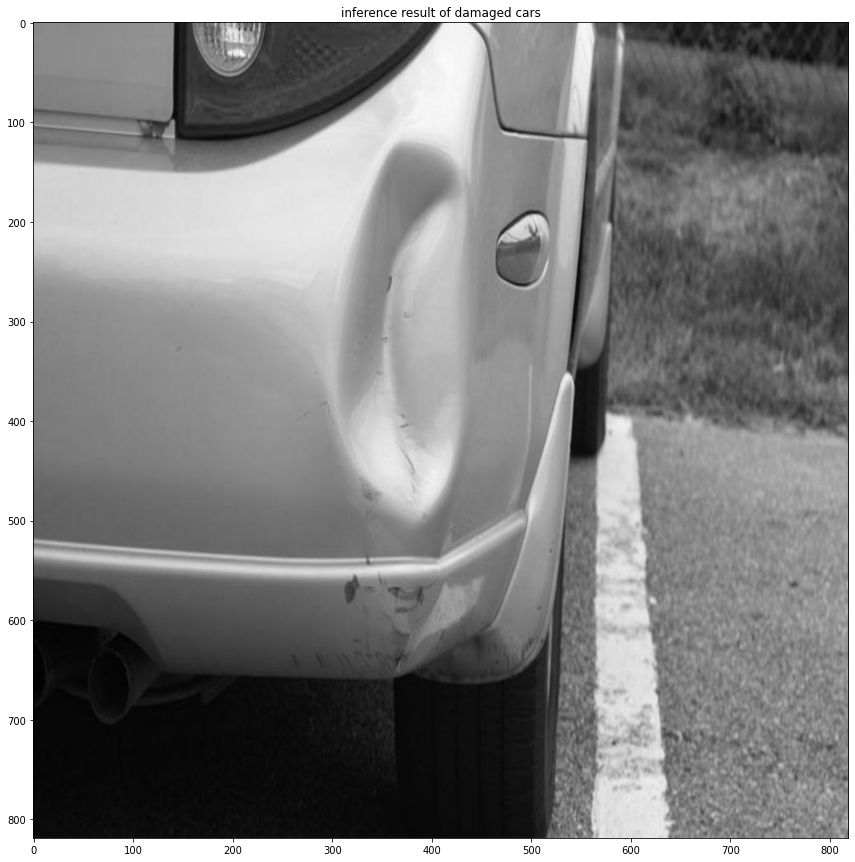

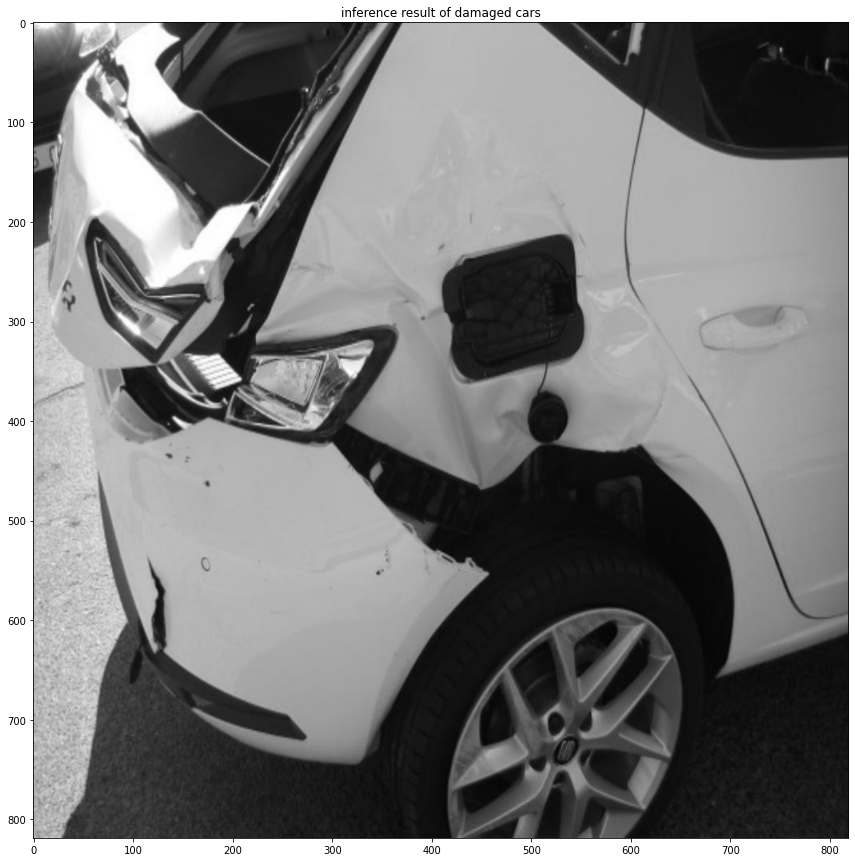

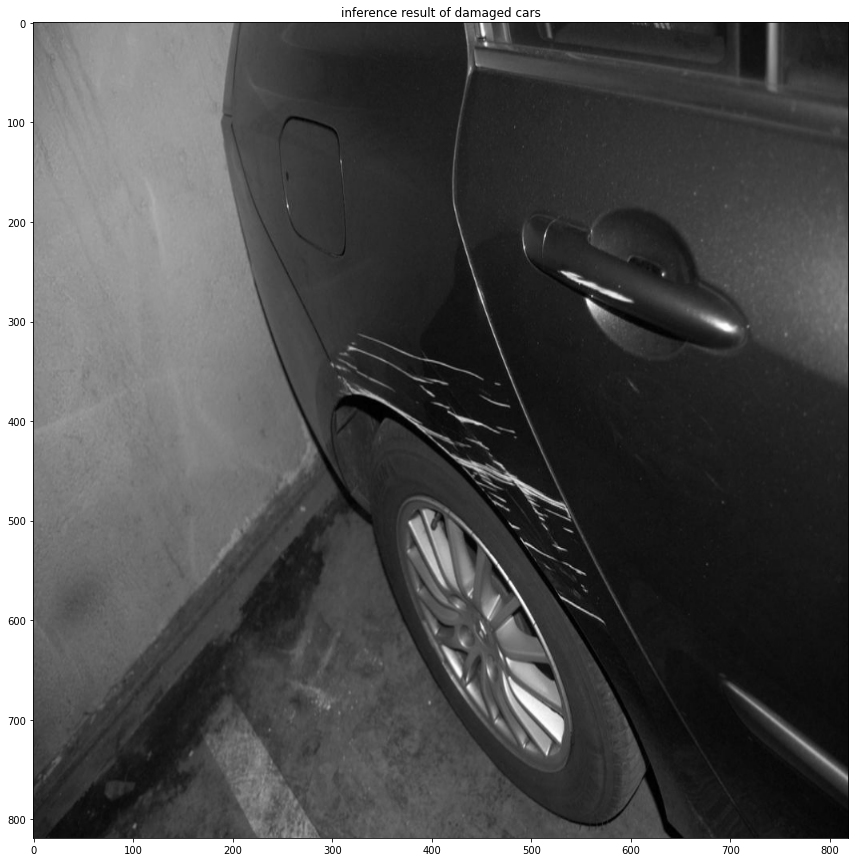

In [11]:
from detectron2.utils.visualizer import ColorMode
dataset_dicts = car_damage_dicts(ROOT_DIR + "dataset/" + STR_img_folder_val)
for d in random.sample(dataset_dicts, 3):    
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)
    v = Visualizer(im[:, :, ::-1],
                   metadata=damage_metadata, 
                   scale=0.8, 
                   instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels
    )
    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
  
    plt.figure(figsize=(15,15))
    plt.imshow(v.get_image()[:, :, ::-1])
    plt.title('inference result of damaged cars')
    plt.show()

In [12]:
# Throughput performance
import time
times = []
for i in range(20):
    start_time = time.time()
    outputs = predictor(im)
    delta = time.time() - start_time
    times.append(delta)
mean_delta = np.array(times).mean()
fps = 1 / mean_delta
print("Average(sec):{:.2f},fps:{:.2f}".format(mean_delta, fps))

Average(sec):0.07,fps:13.83


---------------------------------------------------------------------------------------------------------------------------------------------------------
### 2) COCO Mask R-CNN <b>ResNet-50 FPN 3x</b> Backbone

#### <b>[Step1]</b> Train, Fine-tune a coco-pretrained Mask R-CNN model on the 'car damage' dataset

In [13]:
# Train the model
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("dataset_" + STR_img_folder_train,)
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = PARAM_workers # On Windows
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")
cfg.SOLVER.IMS_PER_BATCH = PARAM_per_batch
cfg.SOLVER.BASE_LR = PARAM_lr
cfg.SOLVER.MAX_ITER = PARAM_iter    # 300 iterations
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = PARAM_batch_size   # default: 512
cfg.MODEL.ROI_HEADS.NUM_CLASSES = PARAM_classes  # two classes: class 0 - scratch, 1 - dent

# added for test of hyper-parameter tuning
cfg.SOLVER.STEPS = (1000, 1500)
cfg.SOLVER.GAMMA = 0.05
cfg.SOLVER.WARMUP_ITERS = 1000

os.makedirs(cfg.OUTPUT_DIR, exist_ok = True)
# trainer =  Trainer(cfg)
trainer = DefaultTrainer(cfg) # do not use TTA
trainer.resume_or_load(resume = False)
trainer.train()

[05/05 16:28:49 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

'roi_heads.box_predictor.cls_score.weight' has shape (81, 1024) in the checkpoint but (3, 1024) in the model! Skipped.
'roi_heads.box_predictor.cls_score.bias' has shape (81,) in the checkpoint but (3,) in the model! Skipped.
'roi_heads.box_predictor.bbox_pred.weight' has shape (320, 1024) in the checkpoint but (8, 1024) in the model! Skipped.
'roi_heads.box_predictor.bbox_pred.bias' has shape (320,) in the checkpoint but (8,) in the model! Skipped.
'roi_heads.mask_head.predictor.weight' has shape (80, 256, 1, 1) in the checkpoint but (2, 256, 1, 1) in the model! Skipped.
'roi_heads.mask_head.predictor.bias' has shape (80,) in the checkpoint but (2,) in the model! Skipped.


[05/05 16:28:56 d2.engine.train_loop]: Starting training from iteration 0
[05/05 16:29:02 d2.utils.events]:  eta: 0:12:39  iter: 19  total_loss: 1.980  loss_cls: 1.038  loss_box_reg: 0.086  loss_mask: 0.694  loss_rpn_cls: 0.111  loss_rpn_loc: 0.019  time: 0.2506  data_time: 0.0173  lr: 0.000001  max_mem: 2026M
[05/05 16:29:07 d2.utils.events]:  eta: 0:12:29  iter: 39  total_loss: 1.948  loss_cls: 1.006  loss_box_reg: 0.098  loss_mask: 0.694  loss_rpn_cls: 0.095  loss_rpn_loc: 0.020  time: 0.2515  data_time: 0.0045  lr: 0.000002  max_mem: 2026M
[05/05 16:29:12 d2.utils.events]:  eta: 0:12:36  iter: 59  total_loss: 1.829  loss_cls: 0.950  loss_box_reg: 0.118  loss_mask: 0.693  loss_rpn_cls: 0.054  loss_rpn_loc: 0.015  time: 0.2540  data_time: 0.0050  lr: 0.000003  max_mem: 2026M
[05/05 16:29:17 d2.utils.events]:  eta: 0:12:33  iter: 79  total_loss: 1.792  loss_cls: 0.877  loss_box_reg: 0.125  loss_mask: 0.692  loss_rpn_cls: 0.064  loss_rpn_loc: 0.017  time: 0.2565  data_time: 0.0052  lr:

In [14]:
# Check training curves in tensorboard
# Before run this script, execute "cd Car_Damage", "tensorboard --logdir output" in anaconda prompt command lines
%load_ext tensorboard
%tensorboard --logdir output

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 1059), started 3:30:13 ago. (Use '!kill 1059' to kill it.)

<IPython.core.display.Javascript object>

#### <b>[Step2]</b> Evaluation with the Trained Model

In [15]:
# Evaluate its performance using AP metric implemented in COCO API (ex. AP of ~70%)
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader

evaluator = COCOEvaluator(STR_dataset_name_coco_val, cfg, False, output_dir="output")
val_loader = build_detection_test_loader(cfg, STR_dataset_name_coco_val)
inference_on_dataset(trainer.model, val_loader, evaluator)

[05/05 16:42:06 d2.data.datasets.coco]: Loaded 8 images in COCO format from /content/gdrive/My Drive/Car_Damage/dataset/annotations/val_base_coco.json
[05/05 16:42:06 d2.data.common]: Serializing 8 elements to byte tensors and concatenating them all ...
[05/05 16:42:06 d2.data.common]: Serialized dataset takes 0.01 MiB
[05/05 16:42:06 d2.evaluation.evaluator]: Start inference on 8 images
[05/05 16:42:09 d2.evaluation.evaluator]: Total inference time: 0:00:00.694741 (0.231580 s / img per device, on 1 devices)
[05/05 16:42:09 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:00 (0.066132 s / img per device, on 1 devices)
[05/05 16:42:09 d2.evaluation.coco_evaluation]: Preparing results for COCO format ...
[05/05 16:42:09 d2.evaluation.coco_evaluation]: Saving results to output/coco_instances_results.json
[05/05 16:42:09 d2.evaluation.coco_evaluation]: Evaluating predictions ...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per im

OrderedDict([('bbox',
              {'AP': 2.9366506503591534,
               'AP-dent': 5.427756746262861,
               'AP-scratch': 0.4455445544554455,
               'AP50': 8.551737526693849,
               'AP75': 1.608910891089109,
               'APl': 3.74244918835775,
               'APm': 0.0,
               'APs': nan}),
             ('segm',
              {'AP': 1.247932725166204,
               'AP-dent': 2.388997620692302,
               'AP-scratch': 0.10686782964010685,
               'AP50': 3.6312995917531947,
               'AP75': 0.0,
               'APl': 1.5507292664750345,
               'APm': 0.0,
               'APs': nan})])

#### <b>[Step3]</b> Inference - Randomly select samples to visualize the prediction results

In [16]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
print(cfg.MODEL.WEIGHTS)
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5   # set the testing threshold for this model
cfg.DATASETS.TEST = (STR_dataset_name_val, )
predictor = DefaultPredictor(cfg)

./output/model_final.pth


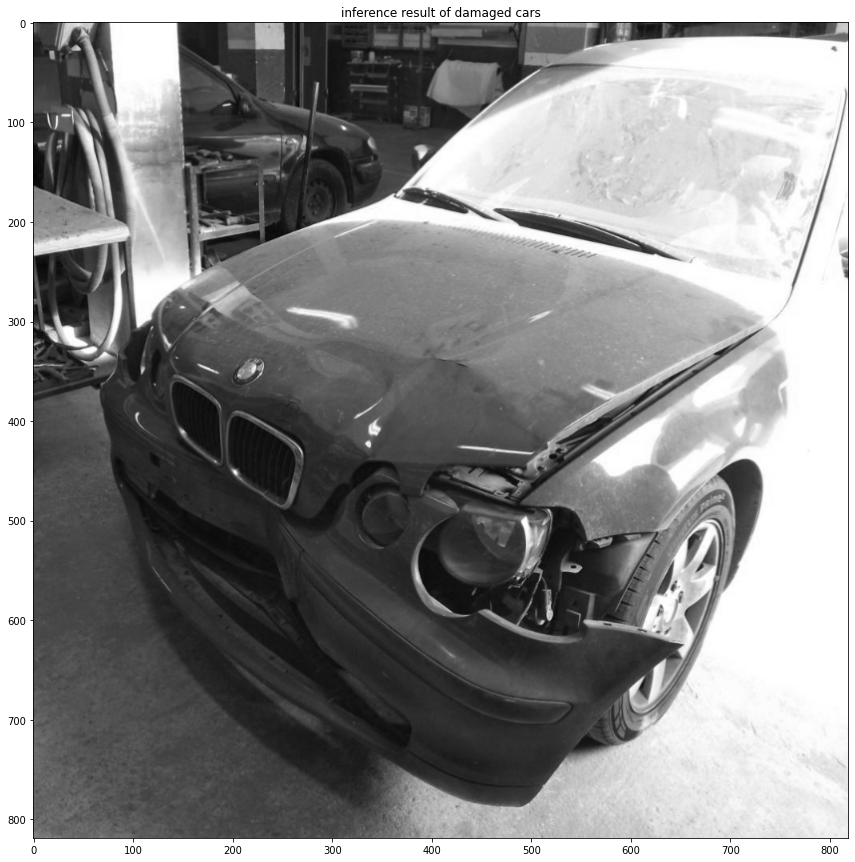

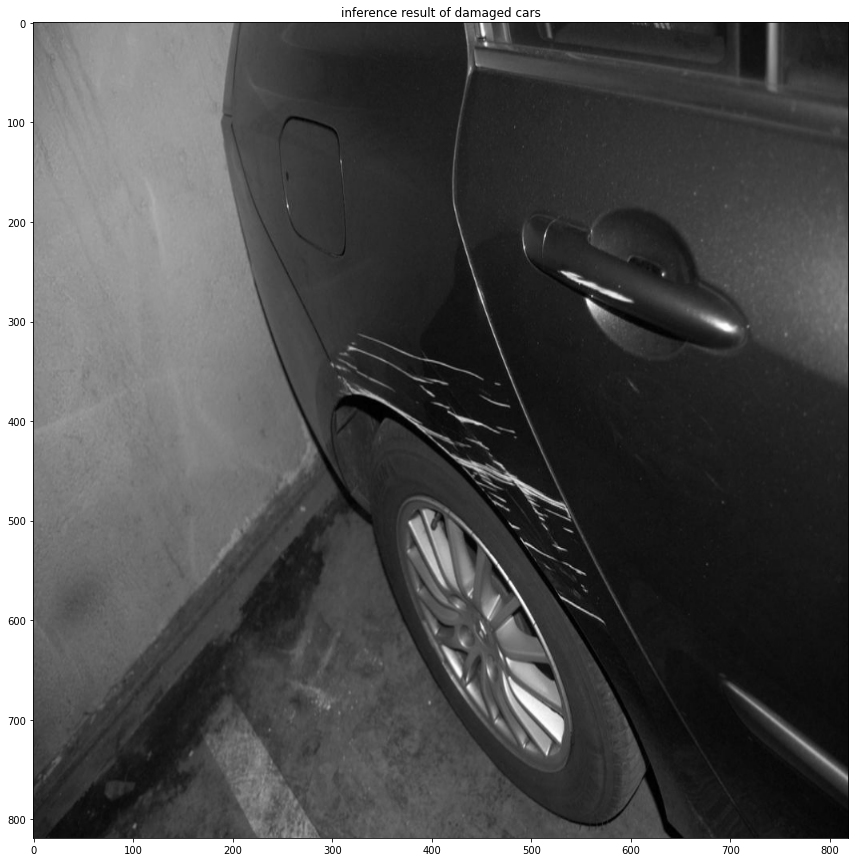

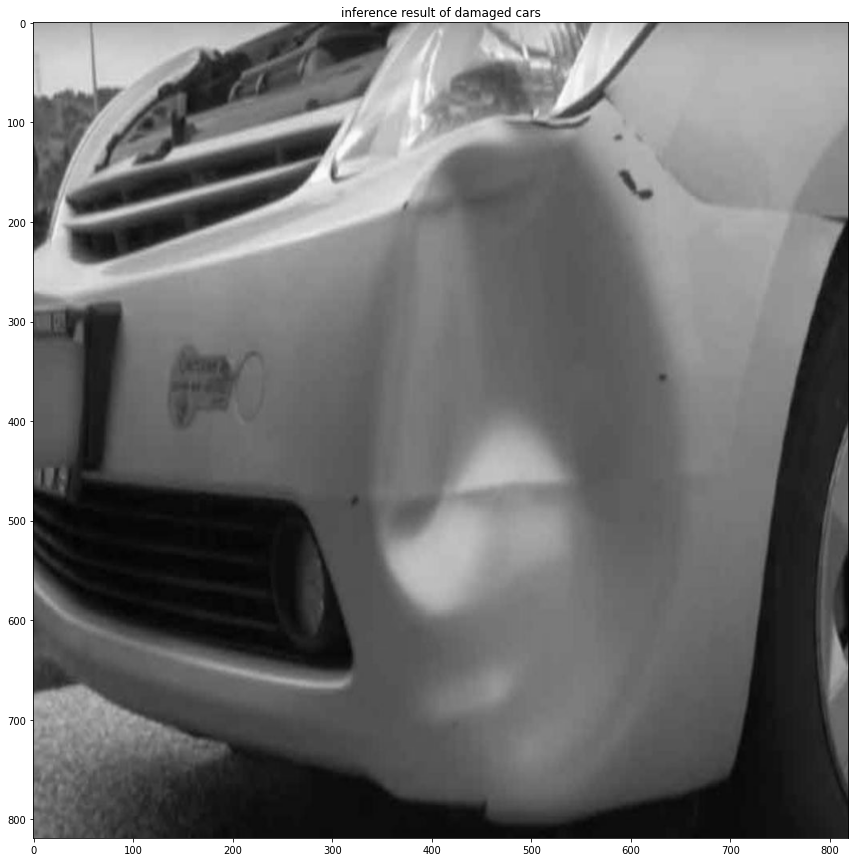

In [17]:
from detectron2.utils.visualizer import ColorMode
dataset_dicts = car_damage_dicts(ROOT_DIR + "dataset/" + STR_img_folder_val)
for d in random.sample(dataset_dicts, 3):    
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)
    v = Visualizer(im[:, :, ::-1],
                   metadata=damage_metadata, 
                   scale=0.8, 
                   instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels
    )
    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
  
    plt.figure(figsize=(15,15))
    plt.imshow(v.get_image()[:, :, ::-1])
    plt.title('inference result of damaged cars')
    plt.show()

In [18]:
# Throughput performance
import time
times = []
for i in range(20):
    start_time = time.time()
    outputs = predictor(im)
    delta = time.time() - start_time
    times.append(delta)
mean_delta = np.array(times).mean()
fps = 1 / mean_delta
print("Average(sec):{:.2f},fps:{:.2f}".format(mean_delta, fps))

Average(sec):0.07,fps:13.61


---------------------------------------------------------------------------------------------------------------------------------------------------------
### 3) COCO Mask R-CNN <b>ResNet-101 FPN 3x</b> Backbone

#### <b>[Step1]</b> Train, Fine-tune a coco-pretrained Mask R-CNN model on the 'car damage' dataset

In [19]:
# Train the model
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_101_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("dataset_" + STR_img_folder_train,)
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = PARAM_workers # On Windows
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_101_FPN_3x.yaml")
cfg.SOLVER.IMS_PER_BATCH = PARAM_per_batch
cfg.SOLVER.BASE_LR = PARAM_lr
cfg.SOLVER.MAX_ITER = PARAM_iter    # 300 iterations
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = PARAM_batch_size   # default: 512
cfg.MODEL.ROI_HEADS.NUM_CLASSES = PARAM_classes  # two classes: class 0 - scratch, 1 - dent

# added for test of hyper-parameter tuning
cfg.SOLVER.STEPS = (1000, 1500)
cfg.SOLVER.GAMMA = 0.05
cfg.SOLVER.WARMUP_ITERS = 1000

os.makedirs(cfg.OUTPUT_DIR, exist_ok = True)
# trainer =  Trainer(cfg)
trainer = DefaultTrainer(cfg) # do not use TTA
trainer.resume_or_load(resume = False)
trainer.train()

[05/05 16:42:15 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

'roi_heads.box_predictor.cls_score.weight' has shape (81, 1024) in the checkpoint but (3, 1024) in the model! Skipped.
'roi_heads.box_predictor.cls_score.bias' has shape (81,) in the checkpoint but (3,) in the model! Skipped.
'roi_heads.box_predictor.bbox_pred.weight' has shape (320, 1024) in the checkpoint but (8, 1024) in the model! Skipped.
'roi_heads.box_predictor.bbox_pred.bias' has shape (320,) in the checkpoint but (8,) in the model! Skipped.
'roi_heads.mask_head.predictor.weight' has shape (80, 256, 1, 1) in the checkpoint but (2, 256, 1, 1) in the model! Skipped.
'roi_heads.mask_head.predictor.bias' has shape (80,) in the checkpoint but (2,) in the model! Skipped.


[05/05 16:42:23 d2.engine.train_loop]: Starting training from iteration 0
[05/05 16:42:29 d2.utils.events]:  eta: 0:16:25  iter: 19  total_loss: 1.757  loss_cls: 0.839  loss_box_reg: 0.072  loss_mask: 0.694  loss_rpn_cls: 0.103  loss_rpn_loc: 0.014  time: 0.3254  data_time: 0.0176  lr: 0.000001  max_mem: 2743M
[05/05 16:42:36 d2.utils.events]:  eta: 0:16:38  iter: 39  total_loss: 1.723  loss_cls: 0.827  loss_box_reg: 0.102  loss_mask: 0.693  loss_rpn_cls: 0.085  loss_rpn_loc: 0.015  time: 0.3343  data_time: 0.0051  lr: 0.000002  max_mem: 2744M
[05/05 16:42:43 d2.utils.events]:  eta: 0:16:42  iter: 59  total_loss: 1.738  loss_cls: 0.786  loss_box_reg: 0.117  loss_mask: 0.693  loss_rpn_cls: 0.082  loss_rpn_loc: 0.017  time: 0.3400  data_time: 0.0047  lr: 0.000003  max_mem: 2744M
[05/05 16:42:50 d2.utils.events]:  eta: 0:16:37  iter: 79  total_loss: 1.631  loss_cls: 0.717  loss_box_reg: 0.086  loss_mask: 0.692  loss_rpn_cls: 0.099  loss_rpn_loc: 0.015  time: 0.3426  data_time: 0.0048  lr:

In [20]:
# Check training curves in tensorboard
# Before run this script, execute "cd Car_Damage", "tensorboard --logdir output" in anaconda prompt command lines
%load_ext tensorboard
%tensorboard --logdir output

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 1059), started 3:47:59 ago. (Use '!kill 1059' to kill it.)

<IPython.core.display.Javascript object>

#### <b>[Step2]</b> Evaluation with the Trained Model

In [21]:
# Evaluate its performance using AP metric implemented in COCO API (ex. AP of ~70%)
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader

evaluator = COCOEvaluator(STR_dataset_name_coco_val, cfg, False, output_dir="output")
val_loader = build_detection_test_loader(cfg, STR_dataset_name_coco_val)
inference_on_dataset(trainer.model, val_loader, evaluator)

[05/05 16:59:52 d2.data.datasets.coco]: Loaded 8 images in COCO format from /content/gdrive/My Drive/Car_Damage/dataset/annotations/val_base_coco.json
[05/05 16:59:52 d2.data.common]: Serializing 8 elements to byte tensors and concatenating them all ...
[05/05 16:59:52 d2.data.common]: Serialized dataset takes 0.01 MiB
[05/05 16:59:52 d2.evaluation.evaluator]: Start inference on 8 images
[05/05 16:59:55 d2.evaluation.evaluator]: Total inference time: 0:00:00.821072 (0.273691 s / img per device, on 1 devices)
[05/05 16:59:55 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:00 (0.088237 s / img per device, on 1 devices)
[05/05 16:59:55 d2.evaluation.coco_evaluation]: Preparing results for COCO format ...
[05/05 16:59:55 d2.evaluation.coco_evaluation]: Saving results to output/coco_instances_results.json
[05/05 16:59:55 d2.evaluation.coco_evaluation]: Evaluating predictions ...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per im

OrderedDict([('bbox',
              {'AP': 7.111257803521216,
               'AP-dent': 13.984891844666194,
               'AP-scratch': 0.2376237623762376,
               'AP50': 11.303416055891303,
               'AP75': 7.497121805203776,
               'APl': 8.463746200404012,
               'APm': 0.0,
               'APs': nan}),
             ('segm',
              {'AP': 4.756839996976795,
               'AP-dent': 9.331683168316829,
               'AP-scratch': 0.18199682563676214,
               'AP50': 8.24257425742574,
               'AP75': 6.564129695412286,
               'APl': 5.7262259326977984,
               'APm': 0.0,
               'APs': nan})])

#### <b>[Step3]</b> Inference - Randomly select samples to visualize the prediction results

In [22]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
print(cfg.MODEL.WEIGHTS)
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5   # set the testing threshold for this model
cfg.DATASETS.TEST = (STR_dataset_name_val, )
predictor = DefaultPredictor(cfg)

./output/model_final.pth


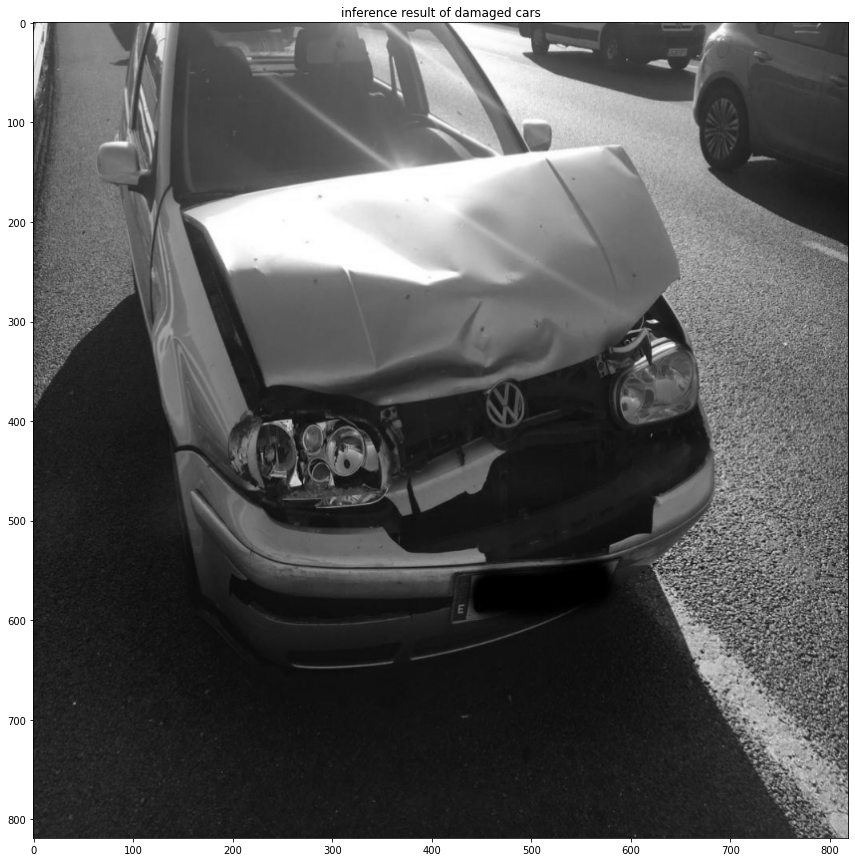

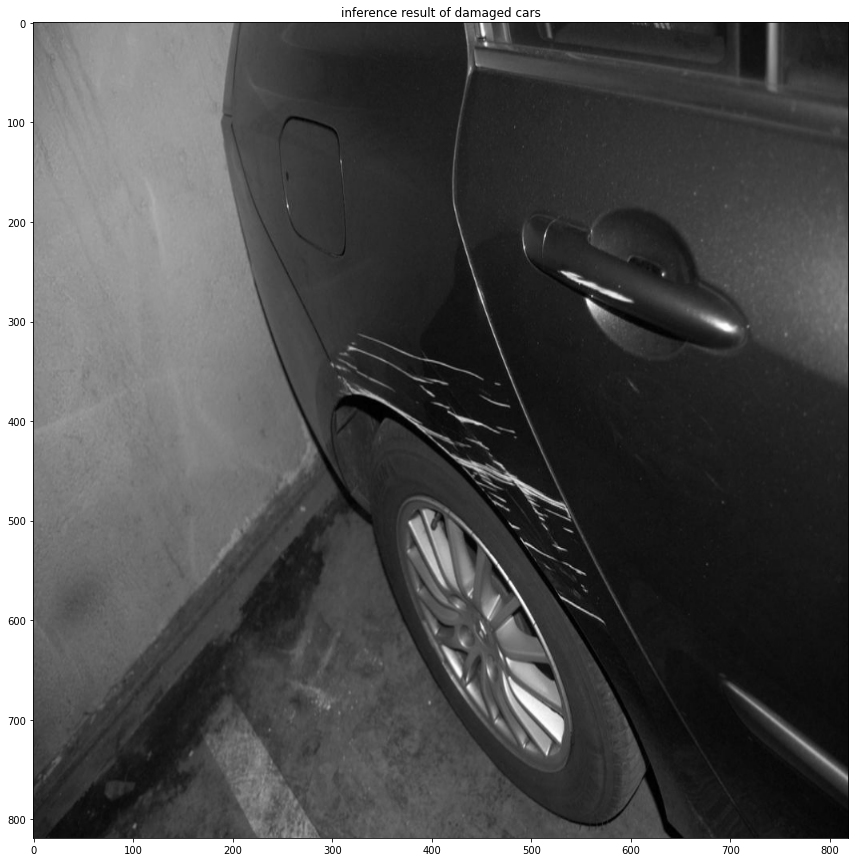

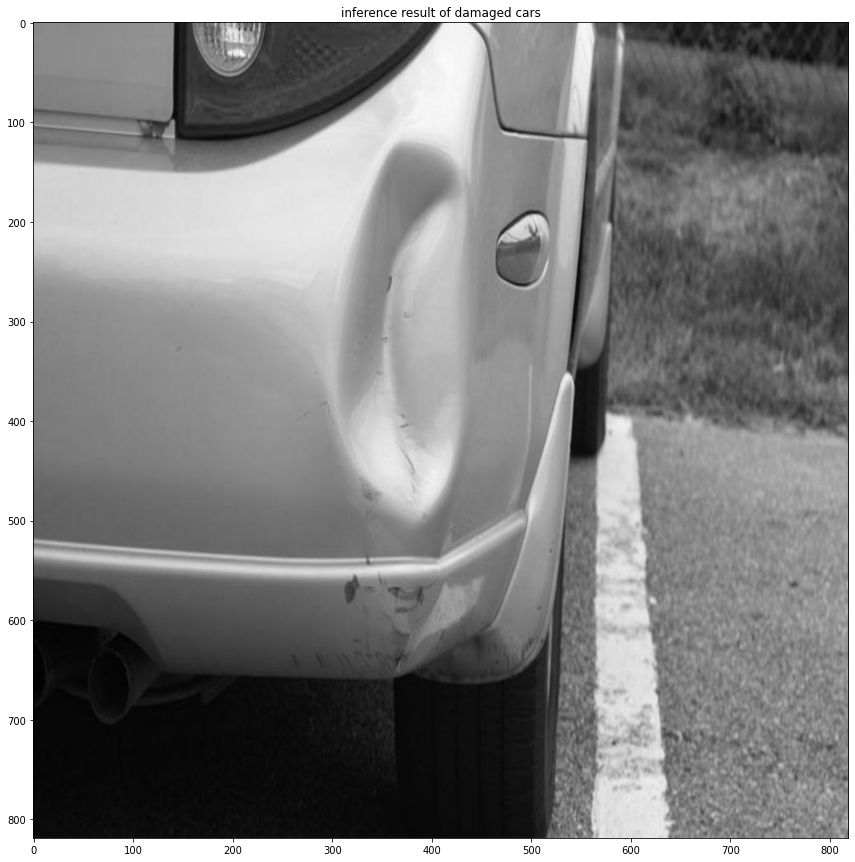

In [23]:
from detectron2.utils.visualizer import ColorMode
dataset_dicts = car_damage_dicts(ROOT_DIR + "dataset/" + STR_img_folder_val)
for d in random.sample(dataset_dicts, 3):    
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)
    v = Visualizer(im[:, :, ::-1],
                   metadata=damage_metadata, 
                   scale=0.8, 
                   instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels
    )
    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
  
    plt.figure(figsize=(15,15))
    plt.imshow(v.get_image()[:, :, ::-1])
    plt.title('inference result of damaged cars')
    plt.show()

In [24]:
# Throughput performance
import time
times = []
for i in range(20):
    start_time = time.time()
    outputs = predictor(im)
    delta = time.time() - start_time
    times.append(delta)
mean_delta = np.array(times).mean()
fps = 1 / mean_delta
print("Average(sec):{:.2f},fps:{:.2f}".format(mean_delta, fps))

Average(sec):0.09,fps:10.92


---------------------------------------------------------------------------------------------------------------------------------------------------------
### 4) LVIS Mask R-CNN <b>ResNet-101 FPN 1x </b> Backbone

#### <b>[Step1]</b> Train, Fine-tune a LVIS-pretrained Mask R-CNN model on the 'car damage' dataset

In [25]:
# Train the model
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("LVIS-InstanceSegmentation/mask_rcnn_R_101_FPN_1x.yaml"))
cfg.DATASETS.TRAIN = ("dataset_" + STR_img_folder_train,)
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = PARAM_workers # On Windows
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("LVIS-InstanceSegmentation/mask_rcnn_R_101_FPN_1x.yaml")
cfg.SOLVER.IMS_PER_BATCH = PARAM_per_batch
cfg.SOLVER.BASE_LR = PARAM_lr
cfg.SOLVER.MAX_ITER = PARAM_iter    # 300 iterations
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = PARAM_batch_size   # default: 512
cfg.MODEL.ROI_HEADS.NUM_CLASSES = PARAM_classes  # two classes: class 0 - scratch, 1 - dent

# added for test of hyper-parameter tuning
cfg.SOLVER.STEPS = (1000, 1500)
cfg.SOLVER.GAMMA = 0.05
cfg.SOLVER.WARMUP_ITERS = 1000

os.makedirs(cfg.OUTPUT_DIR, exist_ok = True)
trainer =  Trainer(cfg) # Only LVIS model will use Aug + TTA with the custom mapper
# trainer = DefaultTrainer(cfg) 
trainer.resume_or_load(resume = False)
trainer.train()

[05/05 17:00:02 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

'roi_heads.box_predictor.cls_score.weight' has shape (1231, 1024) in the checkpoint but (3, 1024) in the model! Skipped.
'roi_heads.box_predictor.cls_score.bias' has shape (1231,) in the checkpoint but (3,) in the model! Skipped.
'roi_heads.box_predictor.bbox_pred.weight' has shape (4920, 1024) in the checkpoint but (8, 1024) in the model! Skipped.
'roi_heads.box_predictor.bbox_pred.bias' has shape (4920,) in the checkpoint but (8,) in the model! Skipped.
'roi_heads.mask_head.predictor.weight' has shape (1230, 256, 1, 1) in the checkpoint but (2, 256, 1, 1) in the model! Skipped.
'roi_heads.mask_head.predictor.bias' has shape (1230,) in the checkpoint but (2,) in the model! Skipped.


[05/05 17:00:09 d2.engine.train_loop]: Starting training from iteration 0
[05/05 17:00:20 d2.utils.events]:  eta: 0:25:47  iter: 19  total_loss: 2.321  loss_cls: 1.417  loss_box_reg: 0.105  loss_mask: 0.695  loss_rpn_cls: 0.051  loss_rpn_loc: 0.020  time: 0.5229  data_time: 0.0262  lr: 0.000001  max_mem: 3980M
[05/05 17:00:30 d2.utils.events]:  eta: 0:25:31  iter: 39  total_loss: 2.165  loss_cls: 1.284  loss_box_reg: 0.109  loss_mask: 0.695  loss_rpn_cls: 0.047  loss_rpn_loc: 0.028  time: 0.5202  data_time: 0.0079  lr: 0.000002  max_mem: 3980M
[05/05 17:00:40 d2.utils.events]:  eta: 0:25:21  iter: 59  total_loss: 2.014  loss_cls: 1.118  loss_box_reg: 0.108  loss_mask: 0.690  loss_rpn_cls: 0.058  loss_rpn_loc: 0.021  time: 0.5210  data_time: 0.0071  lr: 0.000003  max_mem: 3980M
[05/05 17:00:51 d2.utils.events]:  eta: 0:25:10  iter: 79  total_loss: 1.764  loss_cls: 0.887  loss_box_reg: 0.105  loss_mask: 0.686  loss_rpn_cls: 0.070  loss_rpn_loc: 0.024  time: 0.5206  data_time: 0.0074  lr:

In [26]:
# Check training curves in tensorboard
# Before run this script, execute "cd Car_Damage", "tensorboard --logdir output" in anaconda prompt command lines
%load_ext tensorboard
%tensorboard --logdir output

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 1059), started 4:14:48 ago. (Use '!kill 1059' to kill it.)

<IPython.core.display.Javascript object>

#### <b>[Step2]</b> Evaluation with the Trained Model

In [27]:
# Evaluate its performance using AP metric implemented in COCO API (ex. AP of ~70%)
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader

evaluator = COCOEvaluator(STR_dataset_name_coco_val, cfg, False, output_dir="output")
val_loader = build_detection_test_loader(cfg, STR_dataset_name_coco_val)
inference_on_dataset(trainer.model, val_loader, evaluator)

[05/05 17:26:41 d2.data.datasets.coco]: Loaded 8 images in COCO format from /content/gdrive/My Drive/Car_Damage/dataset/annotations/val_base_coco.json
[05/05 17:26:41 d2.data.common]: Serializing 8 elements to byte tensors and concatenating them all ...
[05/05 17:26:41 d2.data.common]: Serialized dataset takes 0.01 MiB
[05/05 17:26:41 d2.evaluation.evaluator]: Start inference on 8 images
[05/05 17:26:51 d2.evaluation.evaluator]: Total inference time: 0:00:03.639079 (1.213026 s / img per device, on 1 devices)
[05/05 17:26:51 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:00 (0.159096 s / img per device, on 1 devices)
[05/05 17:26:51 d2.evaluation.coco_evaluation]: Preparing results for COCO format ...
[05/05 17:26:51 d2.evaluation.coco_evaluation]: Saving results to output/coco_instances_results.json
[05/05 17:26:51 d2.evaluation.coco_evaluation]: Evaluating predictions ...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per im

OrderedDict([('bbox',
              {'AP': 1.5349276713973923,
               'AP-dent': 3.050355083290418,
               'AP-scratch': 0.019500259504366475,
               'AP50': 4.7682635942877285,
               'AP75': 0.2354695822005108,
               'APl': 1.9613021889584241,
               'APm': 0.0,
               'APs': nan}),
             ('segm',
              {'AP': 0.9352860859932501,
               'AP-dent': 1.870572171986501,
               'AP-scratch': 0.0,
               'AP50': 3.923258080503157,
               'AP75': 0.14138122599646935,
               'APl': 1.2933908775492935,
               'APm': 0.0,
               'APs': nan})])

#### <b>[Step3]</b> Inference - Randomly select samples to visualize the prediction results

In [28]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
print(cfg.MODEL.WEIGHTS)
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5   # set the testing threshold for this model
cfg.DATASETS.TEST = (STR_dataset_name_val, )
predictor = DefaultPredictor(cfg)

./output/model_final.pth


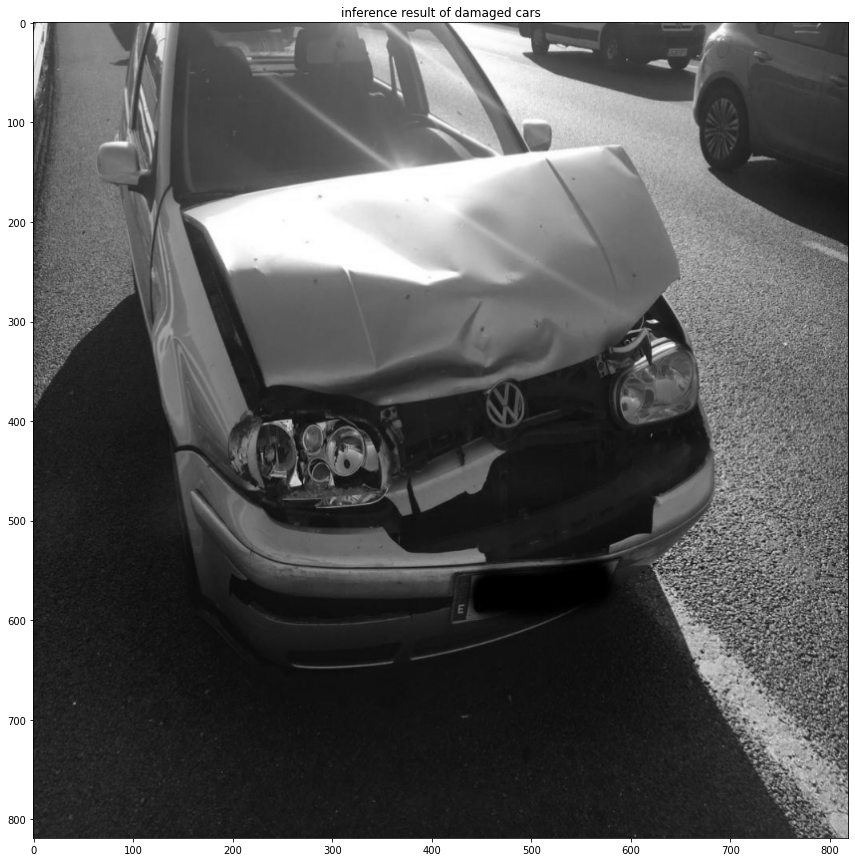

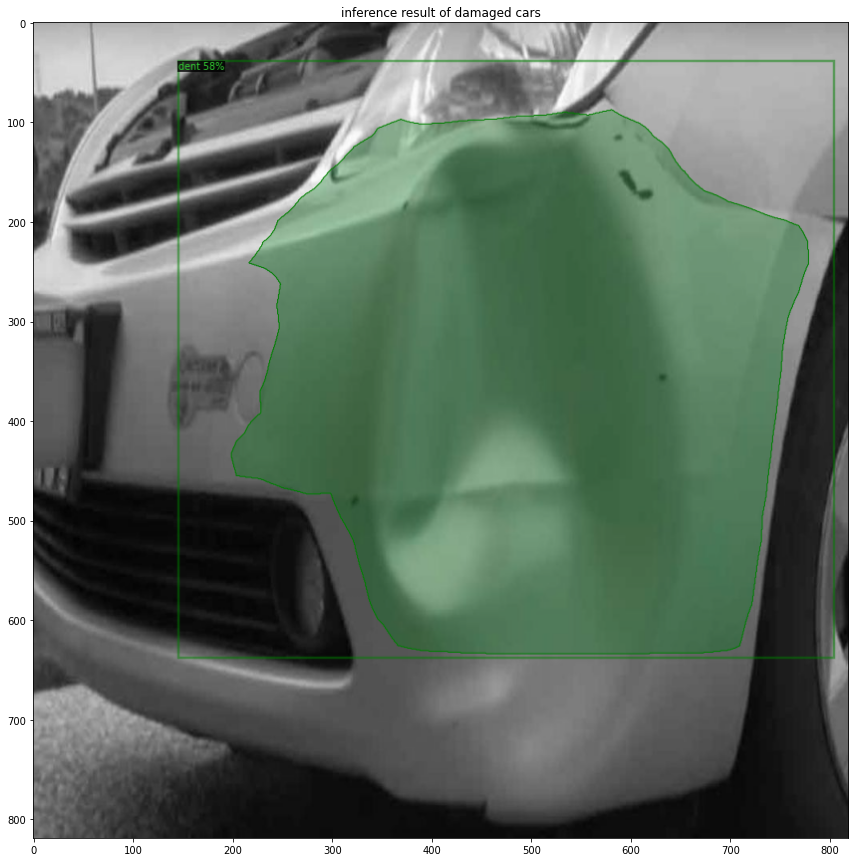

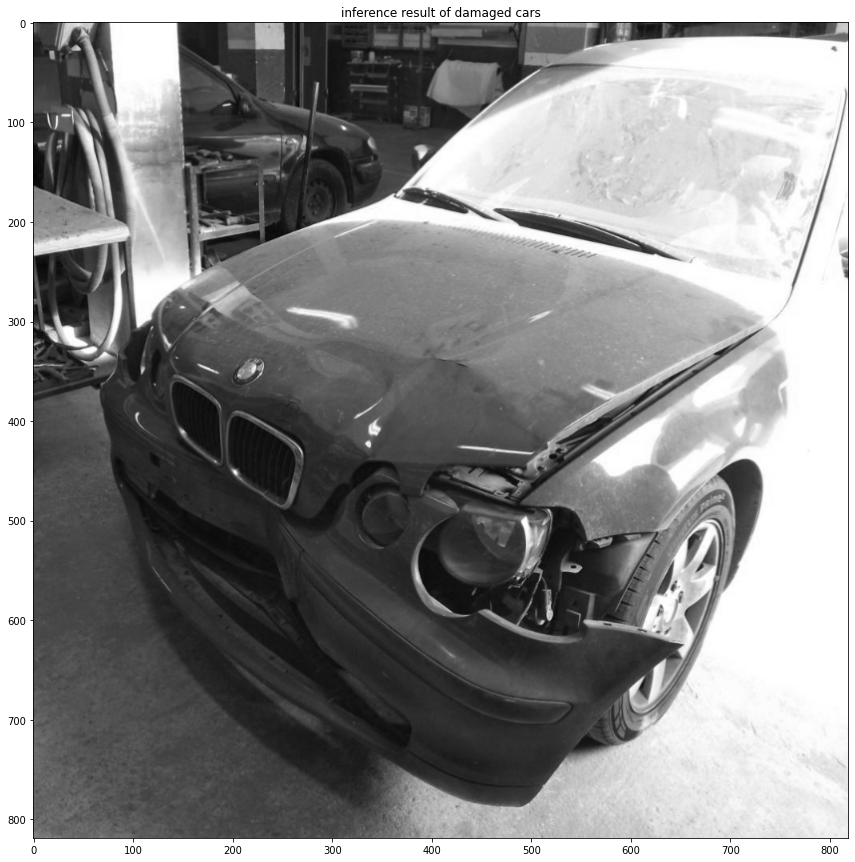

In [29]:
from detectron2.utils.visualizer import ColorMode
dataset_dicts = car_damage_dicts(ROOT_DIR + "dataset/" + STR_img_folder_val)
for d in random.sample(dataset_dicts, 3):    
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)
    v = Visualizer(im[:, :, ::-1],
                   metadata=damage_metadata, 
                   scale=0.8, 
                   instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels
    )
    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
  
    plt.figure(figsize=(15,15))
    plt.imshow(v.get_image()[:, :, ::-1])
    plt.title('inference result of damaged cars')
    plt.show()

In [30]:
# Throughput performance
import time
times = []
for i in range(20):
    start_time = time.time()
    outputs = predictor(im)
    delta = time.time() - start_time
    times.append(delta)
mean_delta = np.array(times).mean()
fps = 1 / mean_delta
print("Average(sec):{:.2f},fps:{:.2f}".format(mean_delta, fps))

Average(sec):0.09,fps:11.00


## <br><b>References

Detectron2 contributors Revision, (2020). Detectron2 Beginner's Tutorial [online]. Google Colab.<br> [Viewed 15 March 2020]. Available from: https://colab.research.google.com/drive/16jcaJoc6bCFAQ96jDe2HwtXj7BMD_-m5<br>



-------------------------------------------------------------------------------

## <b>Set-up Environment for Development</b>


In [0]:
# # install dependencies: (use cu101 because colab has CUDA 10.1)
# !pip install -U torch==1.5 torchvision==0.6 -f https://download.pytorch.org/whl/cu101/torch_stable.html 
# !pip install cython pyyaml==5.1
# !pip install -U 'git+https://github.com/cocodataset/cocoapi.git#subdirectory=PythonAPI'
# import torch, torchvision
# print(torch.__version__, torch.cuda.is_available())
# !gcc --version
# # opencv is pre-installed on colab

In [0]:
# # install detectron2:
# !pip install detectron2==0.1.2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/index.html
# # # You may need to restart your runtime prior to this, to let your installation take effect

In [0]:
# !ls

In [0]:
# from google.colab import drive 
# drive.mount('/content/gdrive/')